In [16]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

In [17]:
def function(w1, w2):
    return (w1**2 + w2 - 11)**2 + (w1 + w2**2 - 7)**2

In [18]:
def gradient(w1, w2):
    dJ_dw1 = 4*w1*(w1**2 + w2 - 11) + 2*(w1 + w2**2 - 7)
    dJ_dw2 = 2*(w1**2 + w2 - 11) + 4*w2*(w1 + w2**2 - 7)
    return np.array([dJ_dw1, dJ_dw2])

In [19]:
learning_rate = 0.01
iterations = 200
initial_point = np.array([-4.0, 0.0])

In [20]:
def gradient_descent():
    w = initial_point.copy()
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        w = w - learning_rate * grad
    return np.array(history)

In [21]:
def sgd():
    w = initial_point.copy()
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        noise = np.random.normal(0, 0.1, size=2)
        grad = grad + noise
        w = w - learning_rate * grad
    return np.array(history)

In [22]:
def mini_batch():
    w = initial_point.copy()
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        noise = np.random.normal(0, 0.05, size=2)
        grad = grad + noise
        w = w - learning_rate * grad
    return np.array(history)

In [23]:
def nesterov():
    w = initial_point.copy()
    v = np.zeros(2)
    momentum = 0.9
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        lookahead = w - momentum * v
        grad = gradient(lookahead[0], lookahead[1])
        v = momentum * v + learning_rate * grad
        w = w - v
    return np.array(history)

In [24]:
def adagrad():
    w = initial_point.copy()
    G = np.zeros(2)
    epsilon = 1e-8
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        G += grad**2
        adjusted_lr = learning_rate / (np.sqrt(G) + epsilon)
        w = w - adjusted_lr * grad
    return np.array(history)

In [25]:
def rmsprop():
    w = initial_point.copy()
    E = np.zeros(2)
    beta = 0.9
    epsilon = 1e-8
    history = []
    for i in range(iterations):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        E = beta * E + (1 - beta) * grad**2
        w = w - learning_rate * grad / (np.sqrt(E) + epsilon)
    return np.array(history)

In [26]:
def adam():
    w = initial_point.copy()
    m = np.zeros(2)
    v = np.zeros(2)
    beta1 = 0.9
    beta2 = 0.999
    epsilon = 1e-8
    history = []
    for t in range(1, iterations+1):
        history.append([w[0], w[1], function(w[0], w[1])])
        grad = gradient(w[0], w[1])
        m = beta1 * m + (1 - beta1) * grad
        v = beta2 * v + (1 - beta2) * (grad**2)
        m_hat = m / (1 - beta1**t)
        v_hat = v / (1 - beta2**t)
        w = w - learning_rate * m_hat / (np.sqrt(v_hat) + epsilon)
    return np.array(history)

In [27]:
gd_hist = gradient_descent()
sgd_hist = sgd()
mb_hist = mini_batch()
nest_hist = nesterov()
ada_hist = adagrad()
rms_hist = rmsprop()
adam_hist = adam()

Animation size has reached 21020261 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


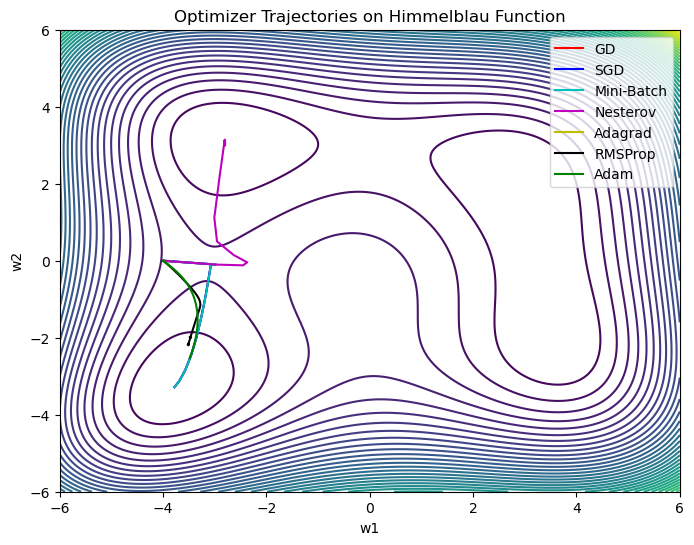

In [28]:
import matplotlib.animation as animation
from IPython.display import HTML

# Create grid
x = np.linspace(-6, 6, 400)
y = np.linspace(-6, 6, 400)
X, Y = np.meshgrid(x, y)
Z = function(X, Y)
fig, ax = plt.subplots(figsize=(8,6))
ax.contour(X, Y, Z, levels=50)
ax.set_title("Optimizer Trajectories on Himmelblau Function")
ax.set_xlabel("w1")
ax.set_ylabel("w2")
gd_line, = ax.plot([], [], 'r-', label="GD")
sgd_line, = ax.plot([], [], 'b-', label="SGD")
mb_line, = ax.plot([], [], 'c-', label="Mini-Batch")
nest_line, = ax.plot([], [], 'm-', label="Nesterov")
ada_line, = ax.plot([], [], 'y-', label="Adagrad")
rms_line, = ax.plot([], [], 'k-', label="RMSProp")
adam_line, = ax.plot([], [], 'g-', label="Adam")
ax.legend()
def update(frame):
    gd_line.set_data(gd_hist[:frame,0], gd_hist[:frame,1])
    sgd_line.set_data(sgd_hist[:frame,0], sgd_hist[:frame,1])
    mb_line.set_data(mb_hist[:frame,0], mb_hist[:frame,1])
    nest_line.set_data(nest_hist[:frame,0], nest_hist[:frame,1])
    ada_line.set_data(ada_hist[:frame,0], ada_hist[:frame,1])
    rms_line.set_data(rms_hist[:frame,0], rms_hist[:frame,1])
    adam_line.set_data(adam_hist[:frame,0], adam_hist[:frame,1])

    return (gd_line, sgd_line, mb_line,
            nest_line, ada_line, rms_line, adam_line)
ani = animation.FuncAnimation(
    fig, update,
    frames=len(gd_hist),
    interval=60,
    blit=True
)
HTML(ani.to_jshtml())

In [ ]:
fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.6)
ax.set_title("3D Optimizer Descent")
ax.set_xlabel("w1")
ax.set_ylabel("w2")
ax.set_zlabel("Loss")
gd_pt, = ax.plot([], [], [], 'ro')
sgd_pt, = ax.plot([], [], [], 'bo')
mb_pt, = ax.plot([], [], [], 'co')
nest_pt, = ax.plot([], [], [], 'mo')
ada_pt, = ax.plot([], [], [], 'yo')
rms_pt, = ax.plot([], [], [], 'ko')
adam_pt, = ax.plot([], [], [], 'go')
def update3d(frame):
    gd_pt.set_data([gd_hist[frame,0]], [gd_hist[frame,1]])
    gd_pt.set_3d_properties([gd_hist[frame,2]])
    sgd_pt.set_data([sgd_hist[frame,0]], [sgd_hist[frame,1]])
    sgd_pt.set_3d_properties([sgd_hist[frame,2]])
    mb_pt.set_data([mb_hist[frame,0]], [mb_hist[frame,1]])
    mb_pt.set_3d_properties([mb_hist[frame,2]])
    nest_pt.set_data([nest_hist[frame,0]], [nest_hist[frame,1]])
    nest_pt.set_3d_properties([nest_hist[frame,2]])
    ada_pt.set_data([ada_hist[frame,0]], [ada_hist[frame,1]])
    ada_pt.set_3d_properties([ada_hist[frame,2]])
    rms_pt.set_data([rms_hist[frame,0]], [rms_hist[frame,1]])
    rms_pt.set_3d_properties([rms_hist[frame,2]])
    adam_pt.set_data([adam_hist[frame,0]], [adam_hist[frame,1]])
    adam_pt.set_3d_properties([adam_hist[frame,2]])
    return (gd_pt, sgd_pt, mb_pt,
            nest_pt, ada_pt, rms_pt, adam_pt)
ani3d = animation.FuncAnimation(
    fig, update3d,
    frames=len(gd_hist),
    interval=60,
    blit=True
)
HTML(ani3d.to_jshtml())